In [ ]:
!pip install transformers datasets timm

In [2]:
!pip install diffusers transformers accelerate safetensors --quiet

# Using diffusion for data augmentation

In [ ]:
import os
import shutil
import torch
from diffusers import StableDiffusionImg2ImgPipeline
from PIL import Image

#loading stable diffusion pipeline
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
).to("cuda")

original_images_path = "/kaggle/input/rockart/rockart/images"
original_labels_path = "/kaggle/input/rockart/rockart/labels"

final_images_path = "/kaggle/working/final_dataset/images"
final_labels_path = "/kaggle/working/final_dataset/labels"

prompt = "rock art, ancient carvings"
strength = 0.3 #set strength
guidance_scale = 7.5
num_aug_per_image = 2 #number of images per original

#save to working folders
os.makedirs(final_images_path, exist_ok=True)
os.makedirs(final_labels_path, exist_ok=True)

def augment_image(img, prompt, strength, guidance_scale, num_outputs):
    img = img.convert("RGB").resize((512, 512))
    augmented = pipe(
        prompt=[prompt] * num_outputs,
        image=[img] * num_outputs,
        strength=strength,
        guidance_scale=guidance_scale,
        num_inference_steps=30
    ).images
    return augmented

image_files = [f for f in os.listdir(original_images_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

for img_file in image_files:
    img_path = os.path.join(original_images_path, img_file)
    label_path = os.path.join(original_labels_path, img_file)

    img = Image.open(img_path)

    #include original image and label in folder too
    shutil.copy(img_path, os.path.join(final_images_path, img_file))
    shutil.copy(label_path, os.path.join(final_labels_path, img_file))

    #generate augmentations
    augmented_imgs = augment_image(img, prompt, strength, guidance_scale, num_aug_per_image)

    base_name = os.path.splitext(img_file)[0]

    for idx, aug_img in enumerate(augmented_imgs):
        aug_img_name = f"{base_name}_aug{idx}.png"
        aug_img.save(os.path.join(final_images_path, aug_img_name))
        shutil.copy(label_path, os.path.join(final_labels_path, aug_img_name))


# Prepare the dataset

In [3]:
from torch.utils.data import Dataset

class SegDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])
        
        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        mask = (mask > 0).long().squeeze(0)
        return image, mask

# Prepare Train and validation dataloader

In [4]:
from torch.utils.data import random_split, DataLoader
from torchvision import transforms

transform = transforms.Compose([
    transforms.Resize((512, 512)),  # force resize
    transforms.ToTensor()
])

full_dataset = SegDataset(
    image_dir='/kaggle/working/final_dataset/images',
    mask_dir='/kaggle/working/final_dataset/labels',  # fixed double slash
    transform=transform
)

#train test split
val_percent = 0.2
val_size = int(len(full_dataset) * val_percent)
train_size = len(full_dataset) - val_size

train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=2, shuffle=False, num_workers=2)


# Loading a pre-trained UPerNet  model with Swin backbone

In [5]:
from transformers import UperNetForSemanticSegmentation

model = UperNetForSemanticSegmentation.from_pretrained(
    "openmmlab/upernet-convnext-small",
    num_labels=2,  # your number of classes
    ignore_mismatched_sizes=True
)

config.json:   0%|          | 0.00/8.76k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/328M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/328M [00:00<?, ?B/s]

Some weights of UperNetForSemanticSegmentation were not initialized from the model checkpoint at openmmlab/upernet-convnext-small and are newly initialized because the shapes did not match:
- decode_head.classifier.weight: found shape torch.Size([150, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- auxiliary_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
- auxiliary_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


# Training pre-trained model on our dataset

In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

#setup device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

#optimizer and loss function
optimizer = optim.AdamW(model.parameters(), lr=5e-5)
criterion = nn.CrossEntropyLoss()

#iou and dice score 
def compute_iou(preds, labels, num_classes=2):
    preds = torch.argmax(preds, dim=1)
    iou = []
    for cls in range(num_classes):
        intersection = torch.sum((preds == cls) & (labels == cls)).float()
        union = torch.sum((preds == cls) | (labels == cls)).float()
        iou.append(intersection / (union + 1e-6))
    return torch.tensor(iou).mean().item()

def compute_dice(preds, labels, smooth=1e-6):
    preds = torch.argmax(preds, dim=1).float()
    labels = labels.float()
    intersection = torch.sum(preds * labels)
    return (2. * intersection + smooth) / (preds.sum() + labels.sum() + smooth)

for epoch in range(5):  
    model.train()
    epoch_loss = 0
    epoch_iou = 0
    epoch_dice = 0

    for images, masks in train_loader:
        images = images.to(device)
        masks = masks.to(device)

        optimizer.zero_grad()
        outputs = model(pixel_values=images).logits  

        #resize output to match the mask size
        outputs = F.interpolate(outputs, size=masks.shape[-2:], mode="bilinear", align_corners=False)

        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

    model.eval()
    val_loss = 0
    val_iou = 0
    val_dice = 0

    with torch.no_grad():
        for images, masks in val_loader:
            images = images.to(device)
            masks = masks.to(device)

            outputs = model(pixel_values=images).logits  

            outputs = F.interpolate(outputs, size=masks.shape[-2:], mode="bilinear", align_corners=False)

            loss = criterion(outputs, masks)
            val_loss += loss.item()

            val_iou += compute_iou(outputs, masks)
            val_dice += compute_dice(outputs, masks)

    #combined IoU and Dice
    combined_iou_dice = (val_iou/len(val_loader) + val_dice/len(val_loader)) / 2

    print(f"Epoch {epoch+1} | "
          f"Train Loss = {epoch_loss/len(train_loader):.4f} | "
          f"Val Loss = {val_loss/len(val_loader):.4f} | "
          f"Val IoU = {val_iou/len(val_loader):.4f} | "
          f"Val Dice = {val_dice/len(val_loader):.4f} | "
          f"Combined Dice & IoU = {combined_iou_dice:.4f}")


Epoch 1 | Train Loss = 0.2851 | Val Loss = 0.2792 | Val IoU = 0.6211 | Val Dice = 0.5113 | Combined Dice & IoU = 0.5662
Epoch 2 | Train Loss = 0.2190 | Val Loss = 0.2139 | Val IoU = 0.7086 | Val Dice = 0.6694 | Combined Dice & IoU = 0.6890
Epoch 3 | Train Loss = 0.1949 | Val Loss = 0.2023 | Val IoU = 0.7256 | Val Dice = 0.6934 | Combined Dice & IoU = 0.7095
Epoch 4 | Train Loss = 0.1779 | Val Loss = 0.2155 | Val IoU = 0.7146 | Val Dice = 0.6721 | Combined Dice & IoU = 0.6933
Epoch 5 | Train Loss = 0.1631 | Val Loss = 0.2137 | Val IoU = 0.7256 | Val Dice = 0.6924 | Combined Dice & IoU = 0.7090


In [7]:
torch.save(model.state_dict(), "/kaggle/working/UperNetWithSwin_finetuned.pth")

# Visualising validation dataset predicted masks

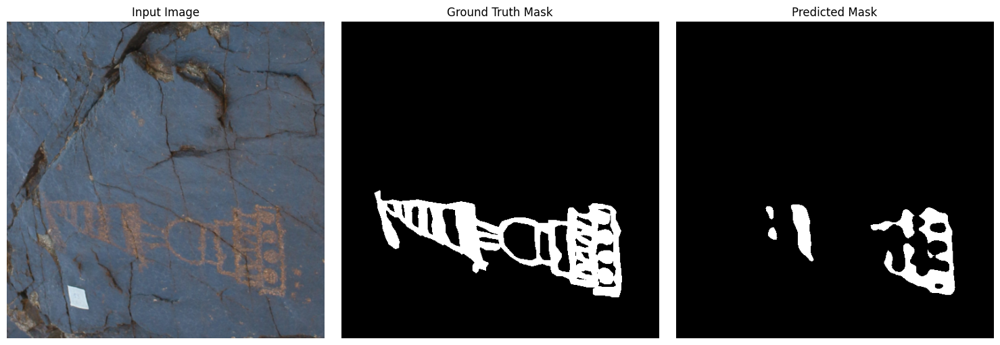

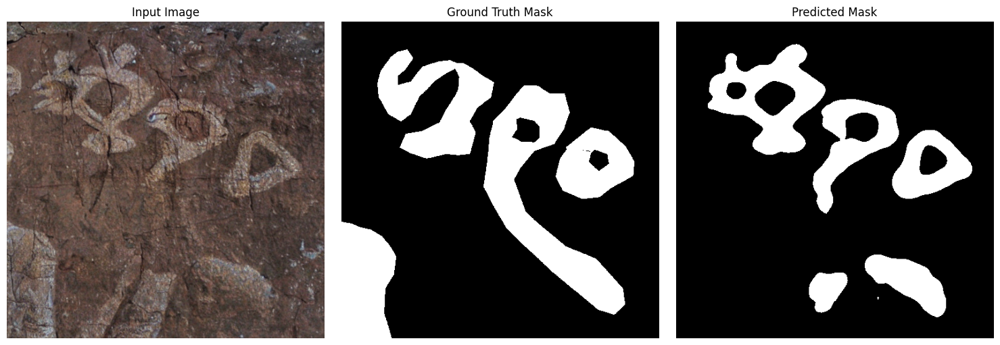

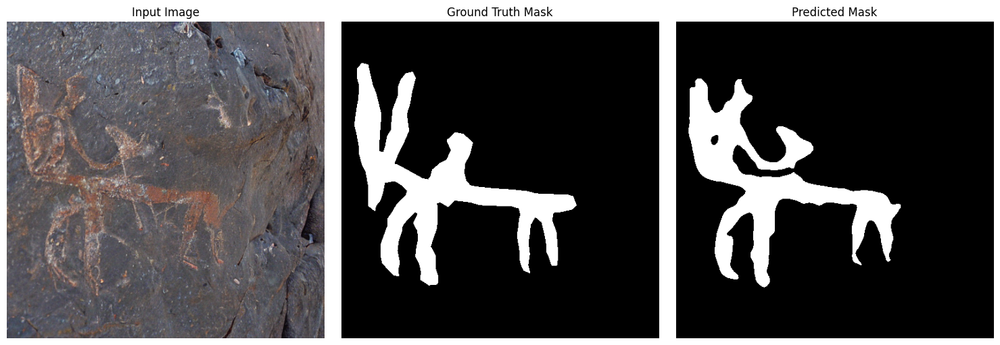

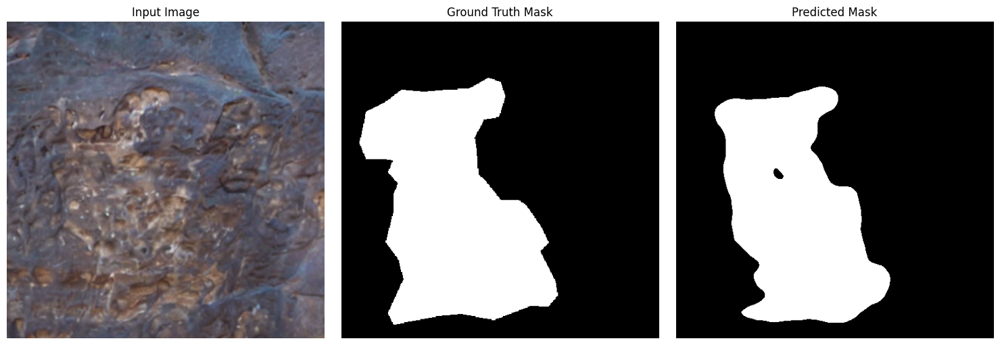

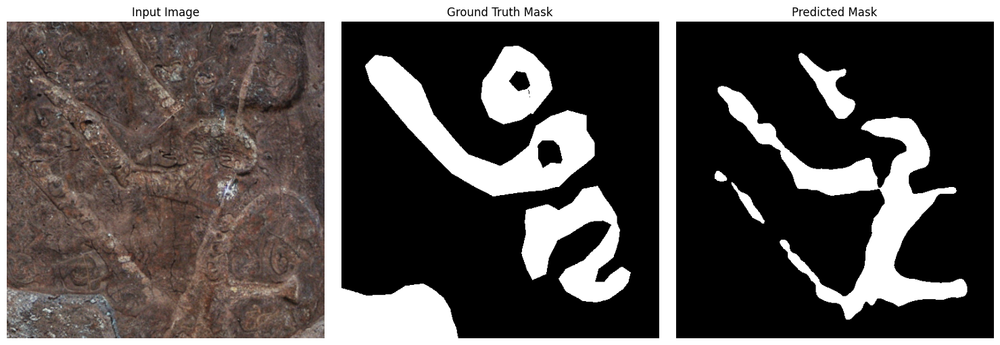

...

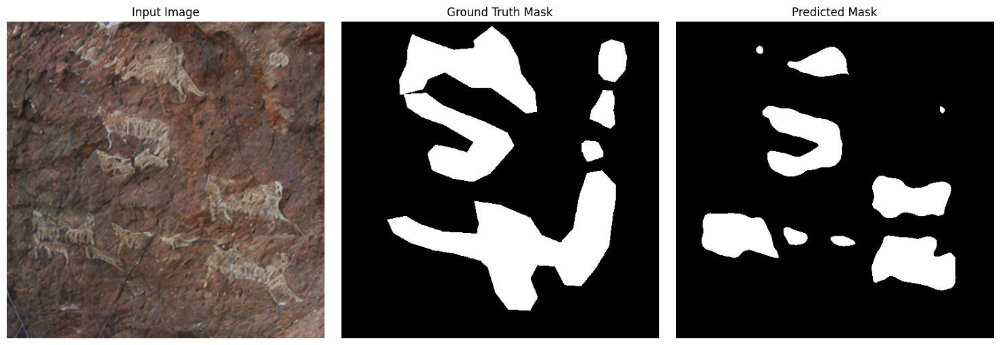

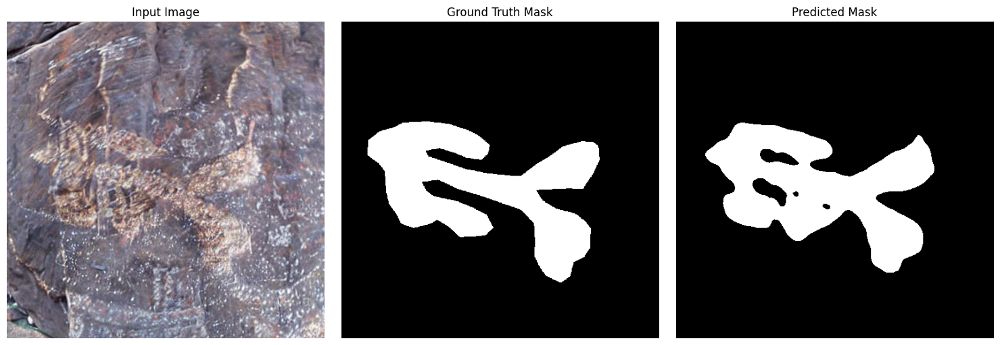

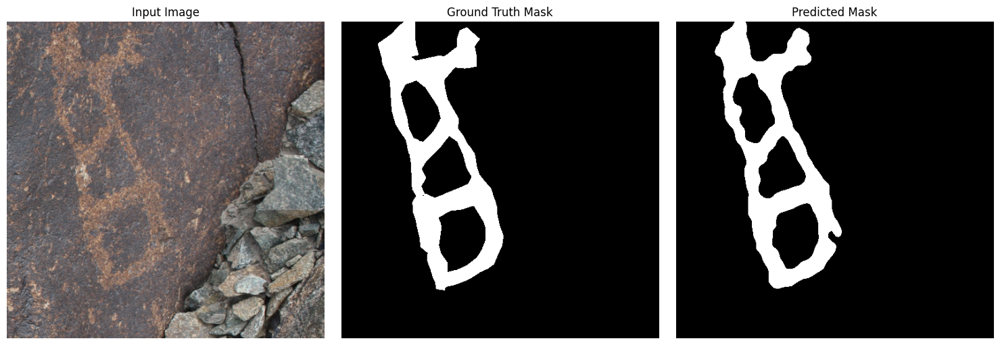

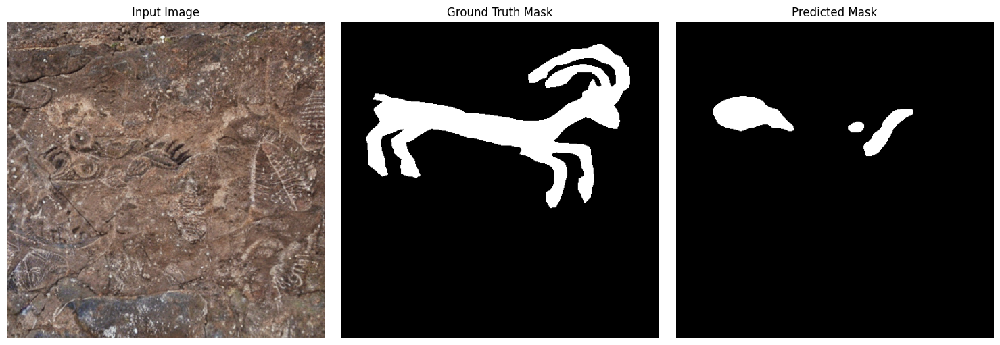

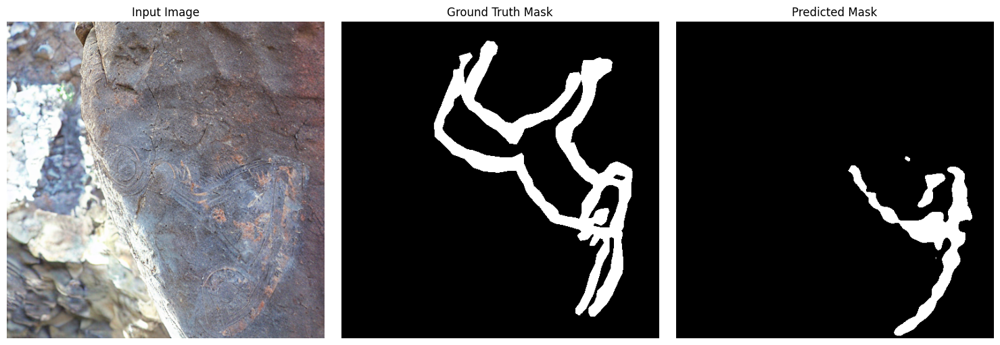

In [13]:
import matplotlib.pyplot as plt
import numpy as np
import torch.nn.functional as F

def decode_segmentation(mask_tensor):
    mask_np = mask_tensor.cpu().numpy()
    color_mask = np.zeros((mask_np.shape[0], mask_np.shape[1], 3), dtype=np.uint8)
    color_mask[mask_np == 1] = [255, 255, 255]  
    return color_mask

def visualize_predictions(model, val_loader, device, max_batches=5):
    model.eval()
    shown = 0

    with torch.no_grad():
        for batch in val_loader:
            inputs, labels = batch
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs).logits
            outputs = F.interpolate(outputs, size=labels.shape[1:], mode="bilinear", align_corners=False)
            preds = torch.argmax(outputs, dim=1)

            for i in range(len(inputs)):
                image_np = inputs[i].permute(1, 2, 0).cpu().numpy()
                label_mask = decode_segmentation(labels[i])
                pred_mask = decode_segmentation(preds[i])

                fig, axes = plt.subplots(1, 3, figsize=(15, 5))
                axes[0].imshow(image_np)
                axes[0].set_title("Input Image")
                axes[1].imshow(label_mask)
                axes[1].set_title("Ground Truth Mask")
                axes[2].imshow(pred_mask)
                axes[2].set_title("Predicted Mask")
                for ax in axes:
                    ax.axis('off')
                plt.tight_layout()
                plt.show()

                shown += 1
                if shown >= max_batches * val_loader.batch_size:
                    return  
visualize_predictions(model, val_loader, device, max_batches=20)
